<br> 


<h1 align='center'> Elon Musk: Twitter Sentiment Analysis <font color='#559E54'> </font> </h1>


<br>


### Table of Contents

1. Mount the topic Elon Musk from a S3 bucket
2. Data Exploration
3. Text Cleaning Preprocessing
4. Putting a pipeline together
5. Get the most predictive words
6. Save data to my S3 bucket
7. Queries to create tables in Athena 

### Objective

This notebook is a comprehensive twitter sentiment analysis that starts with collecting tweets on a public Amazon S3. The process involves leveraging Athena for table creation and Quicksight for dashboard development.

The notebook further explores the capabilities of Spark ML within Databricks, focusing on training a sentiment classification model.

Additionally, it utilizes the trained model to generate predictions, and ultimately saving these predictions back to S3. Finally, it integrates sentiment predictions seamlessly into the Quicksight dashboard for comprehensive visualization and analysis.

In [0]:
# Create a SparkSession
from pyspark.sql import SparkSession
spark = SparkSession \
        .builder \
        .appName('Twitter Sentiment Analysis') \
        .getOrCreate()
print('Session created')

sc = spark.sparkContext

Session created


##### Import Librairies

In [0]:
! pip install nltk

     |████████████████████████████████| 1.5 MB 6.2 MB/s 
     |████████████████████████████████| 78 kB 7.8 MB/s 
     |████████████████████████████████| 773 kB 39.4 MB/s 
You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-7ce72a1b-9df8-42a9-8b57-1c9cf743afd9/bin/python -m pip install --upgrade pip' command.


In [0]:
from pyspark.sql.types import StructType, StructField, IntegerType, StringType,DoubleType
from pyspark.sql.functions import monotonically_increasing_id
from pyspark.sql.functions import col, sum as spark_sum
from pyspark.sql.functions import col, sum
from pyspark.sql.functions import when
from pyspark.sql.functions import regexp_replace, lower, trim, col
import matplotlib.pyplot as plt

import nltk
from pyspark.sql.functions import udf
from pyspark.sql.types import StringType
from nltk.sentiment.vader import SentimentIntensityAnalyzer

import pandas as pd
import numpy as np

from pyspark.ml.feature import NGram, VectorAssembler, StopWordsRemover, HashingTF, IDF, Tokenizer, StringIndexer
from pyspark.ml.feature import CountVectorizer
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import BinaryClassificationEvaluator
from sklearn.metrics import roc_curve, auc

import io
import boto3

###### Function to mount to weclouddata public dataset bucket

In [0]:
# Mount our s3_bucket
def mount_s3_bucket(access_key, secret_key, bucket_name, mount_folder):
  ACCESS_KEY_ID = access_key
  SECRET_ACCESS_KEY = secret_key
  ENCODED_SECRET_KEY = SECRET_ACCESS_KEY.replace("/", "%2F")

  print ("Mounting", bucket_name)

  try:
    # Unmount the data in case it was already mounted.
    dbutils.fs.unmount("/mnt/%s" % mount_folder)
    
  except:
    # If it fails to unmount it most likely wasn't mounted in the first place
    print ("Directory not unmounted: ", mount_folder)
    
  finally:
    # Lastly, mount our bucket.
    dbutils.fs.mount("s3a://%s:%s@%s" % (ACCESS_KEY_ID, ENCODED_SECRET_KEY, bucket_name), "/mnt/%s" % mount_folder)
    #dbutils.fs.mount("s3a://"+ ACCESS_KEY_ID + ":" + ENCODED_SECRET_KEY + "@" + bucket_name, mount_folder)
    print ("The bucket", bucket_name, "was mounted to", mount_folder, "\n")

######  Set my access key and secret access key

In [0]:
# Set AWS programmatic access credentials
ACCESS_KEY = ""
SECRET_ACCESS_KEY = ""

### 1. Mount the topic selected for this project: Elon Musk

In [0]:
#Mounting Weclouddata Twitter folder
mount_s3_bucket(ACCESS_KEY, SECRET_ACCESS_KEY, "weclouddata/twitter/", "sentiment")

Mounting weclouddata/twitter/
/mnt/sentiment has been unmounted.
The bucket weclouddata/twitter/ was mounted to sentiment 




######  Load Sentiment Dataset

In [0]:
#Check the files path
display(dbutils.fs.ls('/mnt/sentiment/ElonMusk/2022/'))

path,name,size,modificationTime
dbfs:/mnt/sentiment/ElonMusk/2022/11/,11/,0,0


In [0]:
# Define and read data from S3 into a DataFrame with the specified schema

em_file = "/mnt/sentiment/ElonMusk/2022/*/*/*"

schema = StructType([
    StructField("id", StringType(), True),
    StructField("name", StringType(), True),
    StructField("username", StringType(), True),
    StructField("tweet", StringType(), True),
    StructField("followers_count", IntegerType(), True),
    StructField("location", StringType(), True),
    StructField("geo", StringType(), True),
    StructField("created_at", StringType(), True),
])

tweets = spark.read \
    .option("header", "true") \
    .option("delimiter", "\t") \
    .option("inferSchema", "true") \
    .schema(schema) \
    .csv(em_file)

In [0]:
display(tweets)

id,name,username,tweet,followers_count,location,geo,created_at
1594755515485143052,Javier Perdomo,Javierperdomo,"RT @MattGertz: Elon Musk interacting with sycophantic right-wing influencers this weekend, a thread.",469,None,None,Mon Nov 21 18:11:58 +0000 2022
1594755517574164481,Casey Reilley,caseyreilley,"RT @MattGertz: Elon Musk interacting with sycophantic right-wing influencers this weekend, a thread.",180,"Hawaii, USA",None,Mon Nov 21 18:11:59 +0000 2022
1594755519868043264,Val Ornelas,_surfcowgirl,"RT @elizableu: I’d like to make something else clear, I don’t work for Twitter, Elon Musk, any government, political party, group etc. I ru…",195,Merica,None,Mon Nov 21 18:11:59 +0000 2022
1594755519981436961,Name Can't be Blank,adrenaline1073,RT @disclosetv: JUST IN - Elon Musk has reinstated Rep. Marjorie Taylor Greene's (R-GA) personal Twitter account.,915,"North Coast, Ohio USA",None,Mon Nov 21 18:11:59 +0000 2022
1594755520526778368,The Original Johnboy 🇺🇸uLtRA MAgA🇺🇸 #WPS,johnboy02131989,RT @BehizyTweets: BREAKING: Elon Musk just reinstated Marjorie Taylor Greene's account https://t.co/4hwc46k6Yx,203,None,None,Mon Nov 21 18:11:59 +0000 2022
1594755520790937611,⚡️Gideon Henry⚡️🇺🇸🍊,GideonHenry,RT @w_terrence: Elon Musk should purchase the rights to the “ THE VIEW “on ABC. I would love to see the look on their faces and watch them…,3684,America,None,Mon Nov 21 18:11:59 +0000 2022
1594755521197785106,Leora Smoot,MomOfTwins57,"RT @DashDobrofsky: CNN's Jake Tapper asked Hakeem Jeffries what his ""reaction"" was to Donald Trump being reinstated on Twitter by Elon Musk…",772,None,None,Mon Nov 21 18:12:00 +0000 2022
1594755522191917056,Howard Lovy,Howard_Lovy,RT @JTAnews: Elon Musk bantered with Kanye West and trolled the Anti-Defamation League this weekend. https://t.co/zvKrrAOP5C,8820,"Traverse City, MI",None,Mon Nov 21 18:12:00 +0000 2022
1594755524024746055,CNM MERCOSUL,CNMMERCOSUL,"RT @TradutordoBR: Jair Bolsonaro: ""Elon Musk, here they call me a myth, I don't know why, but you really are the myth of our freedom."" 🇧🇷🇺🇸…",1598,America do Sul,None,Mon Nov 21 18:12:00 +0000 2022
1594755524003774476,Simon.Mount,pseuderman,@whotheFisfran Watching Elon Musk masterbate,300,London,None,Mon Nov 21 18:12:00 +0000 2022



### 2. Exploratory Data Analysis

In [0]:
tweets.count()

Out[46]: 328395

In [0]:
# Count null values in tweets dataframe

null_counts = tweets.select([spark_sum(col(c).isNull().cast('int')).alias(c) for c in tweets.columns])

# Show the counts of null values in each column
null_counts.show()

+---+----+--------+-----+---------------+--------+---+----------+
| id|name|username|tweet|followers_count|location|geo|created_at|
+---+----+--------+-----+---------------+--------+---+----------+
| 38| 102|     100|  204|            444|     446|551|       549|
+---+----+--------+-----+---------------+--------+---+----------+



In [0]:
# Drop rows containing any null values
tweets_without_nulls = tweets.dropna()

In [0]:
# Count retweets in the 'tweet' column
retweet_count = tweets_without_nulls.filter(col("tweet").startswith("RT @")).count()

print("Number of retweets:", retweet_count)

Number of retweets: 254857


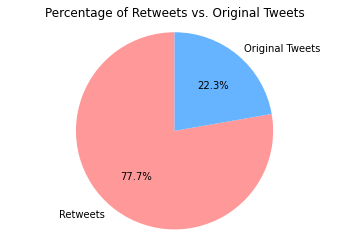

In [0]:
# Count the number of retweets and tweets
retweet_count = tweets_without_nulls.filter(col("tweet").startswith("RT @")).count()
total_tweets = tweets_without_nulls.count()
original_tweet_count = total_tweets - retweet_count

# Calculate percentages
retweet_percentage = (retweet_count / total_tweets) * 100
original_tweet_percentage = 100 - retweet_percentage

# Plotting the pie chart
labels = ['Retweets', 'Original Tweets']
sizes = [retweet_percentage, original_tweet_percentage]
colors = ['#ff9999', '#66b3ff']

plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.axis('equal')
plt.title('Percentage of Retweets vs. Original Tweets')
plt.show()

77,7% of the dataset are retweets. We will therefore keep the retweets to build our sentiment analysis prediction model


##### Create a sentiment column with VADER

In [0]:
# Initialize NLTK's VADER
nltk.download('vader_lexicon')
sid = SentimentIntensityAnalyzer()

# Define a UDF to apply VADER sentiment analysis on the 'tweet' column
def vader_sentiment(text):
    return sid.polarity_scores(text)['compound']

vader_sentiment_udf = udf(vader_sentiment, StringType())

# Apply VADER sentiment analysis to create a new 'sentiment' column in the DataFrame
tweets_score = tweets_without_nulls.withColumn('scores', vader_sentiment_udf(tweets_without_nulls['tweet']))

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


In [0]:
# The column 'scores' is a string. We want to convert to float format to create a 'sentiment' column with Positive, Negative and Neutral sentiments

tweets_score = tweets_score.withColumn('scores', col('scores').cast('float'))

In [0]:
# Classify sentiment based on the 'compound' score and create 'sentiment' column

tweets_score = tweets_score.withColumn('sentiment', 
                                       when(tweets_score['scores'] > 0, 'Positive')
                                       .when(tweets_score['scores'] == 0, 'Neutral')
                                       .otherwise('Negative'))


## 3. Text Cleaning Preprocessing

1. Remove URLs
2. Remove emojis from 'location' column
3. Remove re-tweet: RT @
4. Remove special characters
5. Substituting multiple spaces with single space
6. Lowercase all text
7. Trim the leading/trailing whitespaces

In [0]:
tweets_clean = tweets_score.withColumn('tweet', regexp_replace('tweet', r"http\S+", "")) \
    .withColumn("location_clean", regexp_replace("location", "[^a-zA-Z0-9\\s]", "")) \
    .withColumn('tweet', regexp_replace('tweet', r'@\w+', '')) \
    .withColumn('tweet', regexp_replace('tweet', r'\bRT\b|\bretweet\b', '')) \
    .withColumn('tweet', regexp_replace('tweet', r"[^a-zA-Z\s']", " ")) \
    .withColumn('tweet', regexp_replace('tweet', r"\s+", " ")) \
    .withColumn('tweet', regexp_replace('tweet', r"#[A-Za-z0-9_]+", "")) \
    .withColumn('tweet', lower(col('tweet'))) \
    .withColumn('tweet', trim(col('tweet')))

In [0]:
display(tweets_clean)

id,name,username,tweet,followers_count,location,geo,created_at,scores,sentiment,location_clean
1594755515485143052,Javier Perdomo,Javierperdomo,elon musk interacting with sycophantic right wing influencers this weekend a thread,469,None,None,Mon Nov 21 18:11:58 +0000 2022,0.0,Neutral,None
1594755517574164481,Casey Reilley,caseyreilley,elon musk interacting with sycophantic right wing influencers this weekend a thread,180,"Hawaii, USA",None,Mon Nov 21 18:11:59 +0000 2022,0.0,Neutral,Hawaii USA
1594755519868043264,Val Ornelas,_surfcowgirl,i d like to make something else clear i don t work for twitter elon musk any government political party group etc i ru,195,Merica,None,Mon Nov 21 18:11:59 +0000 2022,0.7783,Positive,Merica
1594755519981436961,Name Can't be Blank,adrenaline1073,just in elon musk has reinstated rep marjorie taylor greene's r ga personal twitter account,915,"North Coast, Ohio USA",None,Mon Nov 21 18:11:59 +0000 2022,0.0,Neutral,North Coast Ohio USA
1594755520526778368,The Original Johnboy 🇺🇸uLtRA MAgA🇺🇸 #WPS,johnboy02131989,breaking elon musk just reinstated marjorie taylor greene's account,203,None,None,Mon Nov 21 18:11:59 +0000 2022,0.0,Neutral,None
1594755520790937611,⚡️Gideon Henry⚡️🇺🇸🍊,GideonHenry,elon musk should purchase the rights to the the view on abc i would love to see the look on their faces and watch them,3684,America,None,Mon Nov 21 18:11:59 +0000 2022,0.6369,Positive,America
1594755521197785106,Leora Smoot,MomOfTwins57,cnn's jake tapper asked hakeem jeffries what his reaction was to donald trump being reinstated on twitter by elon musk,772,None,None,Mon Nov 21 18:12:00 +0000 2022,0.0,Neutral,None
1594755522191917056,Howard Lovy,Howard_Lovy,elon musk bantered with kanye west and trolled the anti defamation league this weekend,8820,"Traverse City, MI",None,Mon Nov 21 18:12:00 +0000 2022,0.0,Neutral,Traverse City MI
1594755524024746055,CNM MERCOSUL,CNMMERCOSUL,jair bolsonaro elon musk here they call me a myth i don't know why but you really are the myth of our freedom,1598,America do Sul,None,Mon Nov 21 18:12:00 +0000 2022,0.0,Neutral,America do Sul
1594755524003774476,Simon.Mount,pseuderman,watching elon musk masterbate,300,London,None,Mon Nov 21 18:12:00 +0000 2022,0.0,Neutral,London


In [0]:
# Selecting only the 'tweet' and 'sentiment' columns and assigning it to 'tweets_sentiment' variable for EDA
tweets_sentiment = tweets_clean.select('tweet', 'sentiment')
tweets_sentiment.show()

+--------------------+---------+
|               tweet|sentiment|
+--------------------+---------+
|elon musk interac...|  Neutral|
|elon musk interac...|  Neutral|
|i d like to make ...| Positive|
|just in elon musk...|  Neutral|
|breaking elon mus...|  Neutral|
|elon musk should ...| Positive|
|cnn's jake tapper...|  Neutral|
|elon musk bantere...|  Neutral|
|jair bolsonaro el...|  Neutral|
|watching elon mus...|  Neutral|
|even though i hav...| Negative|
|wow we lost nearl...| Positive|
|i m jealous of el...| Negative|
|just in elon musk...|  Neutral|
|elon musk interac...|  Neutral|
|elon musk interac...|  Neutral|
|elon musk unbanni...| Negative|
|more layoffs are ...| Negative|
|do you realize ho...| Negative|
|just in elon musk...|  Neutral|
+--------------------+---------+
only showing top 20 rows



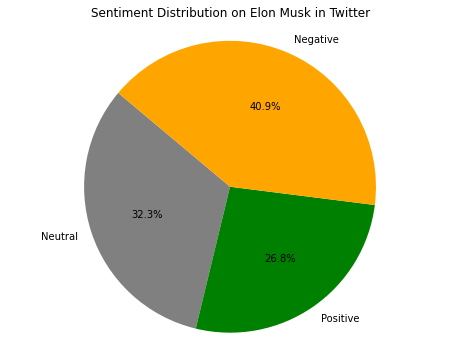

In [0]:
# Pie chart on Sentiment Distribution on Elon Musk in Twitter

colors = {'Positive': 'green', 'Negative': 'orange', 'Neutral': 'gray'}

# Calculate the counts of each sentiment using Spark operations
sentiment_counts = tweets_sentiment.groupBy("sentiment").count().toPandas()

# Calculate percentages
sentiment_counts['percentage'] = (sentiment_counts['count'] / sentiment_counts['count'].sum()) * 100

# Plotting the pie chart using Matplotlib
plt.figure(figsize=(8, 6))
plt.pie(sentiment_counts['percentage'], labels=sentiment_counts['sentiment'], autopct='%1.1f%%', startangle=140, colors=[colors.get(x, '#999999') for x in sentiment_counts['sentiment']])
plt.title('Sentiment Distribution on Elon Musk in Twitter')
plt.axis('equal') 
plt.show()

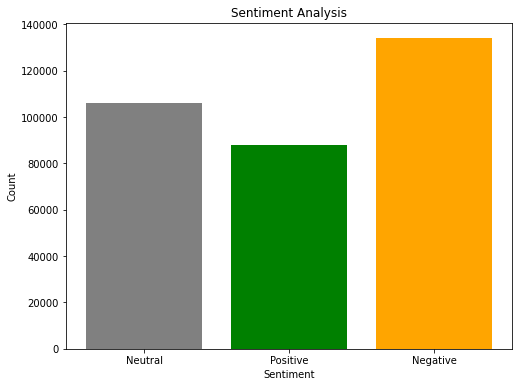

In [0]:
#Bar chart to count Positive, Negative and Neutral tweets

plt.figure(figsize=(8, 6))
plt.bar(sentiment_counts['sentiment'], sentiment_counts['count'], color=[colors[s] for s in sentiment_counts['sentiment']])
plt.xlabel('Sentiment')
plt.ylabel('Count')
plt.title('Sentiment Analysis')
plt.show()

In [0]:
# Remove rows with 'Neutral' sentiment to train a binary classification with logistic regression 
tweets_without_neutral = tweets_sentiment.filter(tweets_sentiment['sentiment'] != 'Neutral')

# Show the resulting DataFrame without 'Neutral' sentiment
display(tweets_without_neutral)

tweet,sentiment
i d like to make something else clear i don t work for twitter elon musk any government political party group etc i ru,Positive
elon musk should purchase the rights to the the view on abc i would love to see the look on their faces and watch them,Positive
even though i have blocked elon musk this disgusting tweet keeps appearing in my feed tweeted by oth,Negative
wow we lost nearly followers since elon musk restored trump's twitter account if you're staying on twitter to,Positive
i m jealous of elon musk s kids they re the only people who never have to hear from him,Negative
elon musk unbanning all the banned people,Negative
more layoffs are reportedly planned on twitter as elon musk brings back the controversial accounts,Negative
do you realize how stupid you have to be to get played by donald trump which is essentially what happened to elon musk was,Negative
conspiracy theorist alex jones won't be returning to twitter and will remain banned from the platform according to elon musk htt,Negative
more layoffs are reportedly planned on twitter as elon musk brings back the controversial accounts,Negative


In [0]:
# Cache the dataframe for faster iteration
tweets_without_neutral.cache() 

Out[17]: DataFrame[tweet: string, sentiment: string]


## 4. Putting a pipeline together

Accuracy Score: 0.9641
ROC-AUC: 0.9850


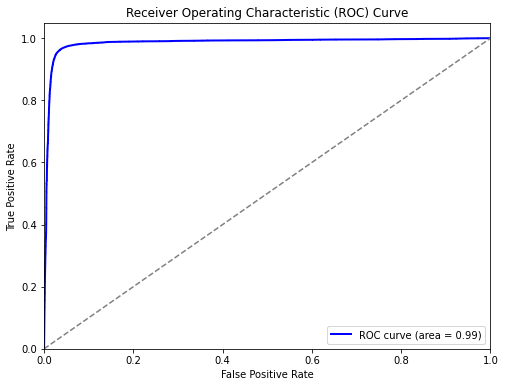

In [0]:
# Use 70% cases for training, 30% cases for testing
train, test = tweets_without_neutral.randomSplit([0.7, 0.3], seed=202008290)

# Create transformers for the ML pipeline
tokenizer = Tokenizer(inputCol="tweet", outputCol="tokens")
stopword_remover = StopWordsRemover(inputCol="tokens", outputCol="filtered")
cv = CountVectorizer(vocabSize=2**16, inputCol="filtered", outputCol='cv')
idf = IDF(inputCol='cv', outputCol="1gram_idf", minDocFreq=5) #minDocFreq: remove sparse terms
assembler = VectorAssembler(inputCols=["1gram_idf"], outputCol="features")
label_encoder= StringIndexer(inputCol = "sentiment", outputCol = "label")
lr = LogisticRegression(maxIter=100)
pipeline = Pipeline(stages=[tokenizer, stopword_remover, cv, idf, assembler, label_encoder, lr])

pipeline_model = pipeline.fit(train)
predictions = pipeline_model.transform(test)

evaluator = BinaryClassificationEvaluator(rawPredictionCol="rawPrediction")
accuracy = predictions.filter(predictions.label == predictions.prediction).count() / float(test.count())
roc_auc = evaluator.evaluate(predictions)
print("Accuracy Score: {0:.4f}".format(accuracy))
print("ROC-AUC: {0:.4f}".format(roc_auc))

# Collect probability and label values for ROC curve
results = predictions.select(['label', 'probability']).collect()
scores_labels = [(float(result['probability'][1]), float(result['label'])) for result in results]

# Calculate ROC curve values in Python (not in Spark)
scores, labels = zip(*scores_labels)
fpr, tpr, _ = roc_curve(labels, scores)
roc_auc = auc(fpr, tpr)

# Plotting the ROC curve using matplotlib
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label='ROC curve (area = {0:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

Accuracy Score: 0.6361
ROC-AUC: 0.8912


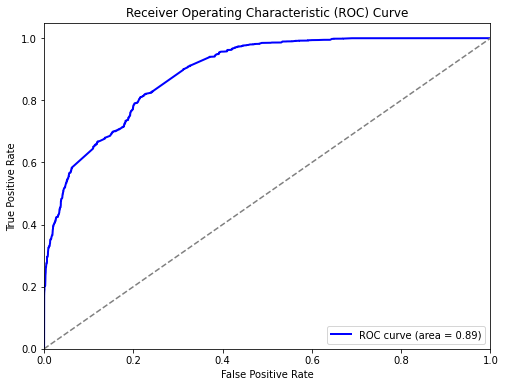

In [0]:
# Random forest model to compare predictions models
rf = RandomForestClassifier(numTrees=100, featuresCol="features", labelCol="label")

# Create the ML pipeline
pipeline = Pipeline(stages=[tokenizer, stopword_remover, cv, idf, assembler, label_encoder, rf])

# Fit the pipeline on the training data
pipeline_model = pipeline.fit(train)

# Make predictions on the test data
predictions = pipeline_model.transform(test)

# Evaluation
evaluator = BinaryClassificationEvaluator(rawPredictionCol="rawPrediction")
accuracy = predictions.filter(predictions.label == predictions.prediction).count() / float(test.count())
roc_auc = evaluator.evaluate(predictions)
print("Accuracy Score: {0:.4f}".format(accuracy))
print("ROC-AUC: {0:.4f}".format(roc_auc))

# Collect probability and label values for ROC curve
results = predictions.select(['label', 'probability']).collect()
scores_labels = [(float(result['probability'][1]), float(result['label'])) for result in results]

# Calculate ROC curve values in Python (not in Spark)
scores, labels = zip(*scores_labels)
fpr, tpr, _ = roc_curve(labels, scores)
roc_auc = auc(fpr, tpr)

# Plotting the ROC curve using matplotlib
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label='ROC curve (area = {0:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

The basic Logistic Regression model has exhibited superior performance compared to Random forest. As a result, we've decided to retain this model specifically and proceed to save it into our designated S3 bucket

In [0]:
display(predictions)

tweet,sentiment,cv,1gram_idf,features,label,rawPrediction,probability,prediction,tokens_as_string,filtered_as_string
'can't think of a worse curse' elon musk on immortality as world population tops billion,Positive,"Map(vectorType -> sparse, length -> 24530, indices -> List(0, 1, 22, 40, 55, 698, 2189, 3629, 16698, 22036, 23082), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))","Map(vectorType -> sparse, length -> 24530, indices -> List(0, 1, 22, 40, 55, 698, 2189, 3629, 16698, 22036, 23082), values -> List(0.31197275836517113, 0.3394724614688773, 3.4000448516026025, 3.723894388062444, 3.920245038931631, 6.05820235259128, 7.689925309814816, 8.817110970926981, 0.0, 0.0, 0.0))","Map(vectorType -> sparse, length -> 24530, indices -> List(0, 1, 22, 40, 55, 698, 2189, 3629), values -> List(0.31197275836517113, 0.3394724614688773, 3.4000448516026025, 3.723894388062444, 3.920245038931631, 6.05820235259128, 7.689925309814816, 8.817110970926981))",1.0,"Map(vectorType -> dense, length -> 2, values -> List(-8.110579870298167, 8.110579870298167))","Map(vectorType -> dense, length -> 2, values -> List(3.002544819068472E-4, 0.9996997455180932))",1.0,'can't think of a worse curse' elon musk on immortality as world population tops billion,'can't think worse curse' elon musk immortality world population tops billion
'hey stop defaming me ' elon musk faces off with anti defamation league ceo via,Negative,"Map(vectorType -> sparse, length -> 24530, indices -> List(0, 1, 215, 263, 283, 311, 355, 490, 1090, 1102, 3748, 7154), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))","Map(vectorType -> sparse, length -> 24530, indices -> List(0, 1, 215, 263, 283, 311, 355, 490, 1090, 1102, 3748, 7154), values -> List(0.31197275836517113, 0.3394724614688773, 4.630094752858737, 4.854229548265344, 4.945004572904278, 5.083590736190424, 5.263005917677165, 5.622884281333435, 6.6443374894549265, 6.654287820308094, 8.694508648834649, 9.873163645176295))","Map(vectorType -> sparse, length -> 24530, indices -> List(0, 1, 215, 263, 283, 311, 355, 490, 1090, 1102, 3748, 7154), values -> List(0.31197275836517113, 0.3394724614688773, 4.630094752858737, 4.854229548265344, 4.945004572904278, 5.083590736190424, 5.263005917677165, 5.622884281333435, 6.6443374894549265, 6.654287820308094, 8.694508648834649, 9.873163645176295))",0.0,"Map(vectorType -> dense, length -> 2, values -> List(10.850135165690116, -10.850135165690116))","Map(vectorType -> dense, length -> 2, values -> List(0.9999805983911998, 1.9401608800206915E-5))",0.0,'hey stop defaming me ' elon musk faces off with anti defamation league ceo via,'hey stop defaming ' elon musk faces anti defamation league ceo via
'it's entertaining but he may as well be burning money ' editor and columnist james ball explains the 'unhinged' 'chaos' on twitt,Positive,"Map(vectorType -> sparse, length -> 24530, indices -> List(117, 164, 389, 490, 807, 1191, 1607, 2382, 3285, 3973, 4526, 4751, 4876, 5351, 5357), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))","Map(vectorType -> sparse, length -> 24530, indices -> List(117, 164, 389, 490, 807, 1191, 1607, 2382, 3285, 3973, 4526, 4751, 4876, 5351, 5357), values -> List(4.267821243333347, 4.485805711837529, 5.3459550006579155, 5.622884281333435, 6.265629830516311, 6.770821636564046, 7.216406738461636, 7.84173132268282, 8.42624466223997, 8.774551356508185, 9.00816620768969, 9.119391842799915, 9.18001646461635, 9.387655829394594, 9.387655829394594))","Map(vectorType -> sparse, length -> 24530, indices -> List(117, 164, 389, 490, 807, 1191, 1607, 2382, 3285, 3973, 4526, 4751, 4876, 5351, 5357), values -> List(4.267821243333347, 4.485805711837529, 5.3459550006579155, 5.622884281333435, 6.265629830516311, 6.770821636564046, 7.216406738461636, 7.84173132268282, 8.42624466223997, 8.774551356508185, 9.00816620768969, 9.119391842799915, 9.18001646461635, 9.387655829394594, 9.387655829394594))",1.0,"Map(v


## 5. Get the most predictive words

In [0]:
#Create 2 lists of good and bad predictive words for further analysis
lr_model = pipeline_model.stages[-1]

# Extracting the coefficients of the model
coefficients = lr_model.coefficients.toArray()

# Extracting the vocabulary (words) from CountVectorizer
vocab = pipeline_model.stages[2].vocabulary

# Pairing coefficients with corresponding words
word_coefficients = sorted(zip(vocab, coefficients), key=lambda x: x[1], reverse=True)

# Displaying the top and bottom words based on coefficients
num_top_words = 10
top_words = word_coefficients[:num_top_words]
bottom_words = word_coefficients[-num_top_words:]

print("Top Predictive Words:")
for word, coeff in top_words:
    print(f"{word}: {coeff}")

print("\nBottom Predictive Words:")
for word, coeff in bottom_words:
    print(f"{word}: {coeff}")


Top Predictive Words:
satisfy: 5.582356839606164
cute: 4.696415922120447
milestones: 4.419221003592721
equality: 4.284722507701139
cobalt: 4.217211632475819
lovely: 4.007694286842574
respectful: 3.9642354756462073
penalties: 3.8577352846983164
incentive: 3.8267883461545273
reaches: 3.6512845105230043

Bottom Predictive Words:
messy: -3.2398719872139465
raping: -3.302306278344018
mines: -3.386933415413826
inconvenience: -3.5824585442929533
ungrateful: -3.674040238162446
ftxbankruptcy: -3.94244426188258
mystique: -3.978071405612649
devil: -4.1479779887989014
postponing: -4.342218838711443
obstacles: -6.43319486096328


In [0]:
# Creating a dataframe of the top and bottom words based on coefficients
num_top_words = 10
top_words = word_coefficients[:num_top_words]
bottom_words = word_coefficients[-num_top_words:]

# Convert NumPy types to Python native types
top_words = [(word, float(coeff)) for word, coeff in top_words]
bottom_words = [(word, float(coeff)) for word, coeff in bottom_words]

# Create DataFrames for top and bottom words with coefficients
schema = StructType([
    StructField("word", StringType(), True),
    StructField("coeff", DoubleType(), True)
])

top_words_df = spark.createDataFrame(top_words, schema)
bottom_words_df = spark.createDataFrame(bottom_words, schema)

# Rename specific columns in DataFrames
top_words_df = top_words_df.select(col("word").alias("good word"), col("coeff").alias("good coeff"))
bottom_words_df = bottom_words_df.select(col("word").alias("bad word"), col("coeff").alias("bad coeff"))

# Add an index column to maintain the order
top_words_df = top_words_df.withColumn("index", monotonically_increasing_id())
bottom_words_df = bottom_words_df.withColumn("index", monotonically_increasing_id())

# Join the DataFrames on the index column
words_predictive = top_words_df.join(bottom_words_df, "index", "inner").drop("index")

# Display the resulting DataFrame
display(words_predictive)

good word,good coeff,bad word,bad coeff
satisfy,5.582356839606164,messy,-3.2398719872139465
cute,4.696415922120447,raping,-3.302306278344018
milestones,4.419221003592721,mines,-3.386933415413826
equality,4.284722507701139,inconvenience,-3.5824585442929533
cobalt,4.217211632475819,ungrateful,-3.674040238162446
lovely,4.007694286842574,ftxbankruptcy,-3.94244426188258
respectful,3.9642354756462073,mystique,-3.978071405612649
penalties,3.8577352846983164,devil,-4.1479779887989014
incentive,3.8267883461545273,postponing,-4.342218838711443
reaches,3.6512845105230043,obstacles,-6.43319486096328



## 6. Save my raw, clean, prediction data and predictive words to the s3 bucket

In [0]:
# Raw Data

# Convert DataFrame to CSV string
csv_data = tweets.toPandas().to_csv(sep='\t', header=False, index=False)

aws_access_key = ''
aws_secret_key = ''
bucket_name = 'b4-pascal878-awscli'
key_name = 'project/raw_data.csv'  # Path in S3 bucket

# Create a session using your AWS credentials
s3 = boto3.client('s3', aws_access_key_id=aws_access_key, aws_secret_access_key=aws_secret_key)

# Upload the CSV string directly to S3
s3.put_object(Bucket=bucket_name, Key=key_name, Body=csv_data.encode('utf-8'))

Out[28]: {'ResponseMetadata': {'RequestId': 'C0C4DCVQ40YRV612',
  'HostId': '/kTQ4frRbvzi7lOiEvlNqUrvCzO200cycjTaisgfQwuQz5VXRqNt227eXbtzVlRlyLojmyWN4/4=',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amz-id-2': '/kTQ4frRbvzi7lOiEvlNqUrvCzO200cycjTaisgfQwuQz5VXRqNt227eXbtzVlRlyLojmyWN4/4=',
   'x-amz-request-id': 'C0C4DCVQ40YRV612',
   'date': 'Tue, 21 Nov 2023 15:03:25 GMT',
   'x-amz-server-side-encryption': 'AES256',
   'etag': '"e28ba35ac308541170a657e76c4ae79b"',
   'server': 'AmazonS3',
   'content-length': '0'},
  'RetryAttempts': 0},
 'ETag': '"e28ba35ac308541170a657e76c4ae79b"',
 'ServerSideEncryption': 'AES256'}

In [0]:
# Clean Data

csv_data = tweets_clean.toPandas().to_csv(sep='\t', header=False, index=False)

aws_access_key = ''
aws_secret_key = ''
bucket_name = 'b4-pascal878-awscli'
key_name = 'clean_data/clean_data.csv'  # Path in my S3 bucket

s3 = boto3.client('s3', aws_access_key_id=aws_access_key, aws_secret_access_key=aws_secret_key)

# Upload the CSV string directly to S3
s3.put_object(Bucket=bucket_name, Key=key_name, Body=csv_data.encode('utf-8'))

Out[29]: {'ResponseMetadata': {'RequestId': 'BN8ZDB8KJEGMSJRW',
  'HostId': 'fNtG71GMrF50zClUicDF2NAFYKnvvyoECBaA0Vf64FxANJkXGqQuWW46MJQGTnVM9iJSHhicYj8=',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amz-id-2': 'fNtG71GMrF50zClUicDF2NAFYKnvvyoECBaA0Vf64FxANJkXGqQuWW46MJQGTnVM9iJSHhicYj8=',
   'x-amz-request-id': 'BN8ZDB8KJEGMSJRW',
   'date': 'Sat, 25 Nov 2023 19:19:11 GMT',
   'x-amz-server-side-encryption': 'AES256',
   'etag': '"d09fe93b15b9395bdd68b7de356cc47d"',
   'server': 'AmazonS3',
   'content-length': '0'},
  'RetryAttempts': 0},
 'ETag': '"d09fe93b15b9395bdd68b7de356cc47d"',
 'ServerSideEncryption': 'AES256'}

In [0]:
# Drop all vector type columns to save on s3 bucket ('tokens_as_string','filtered_as_string' were created for testing purposes but not used)
filtered_predictions = predictions.select([col for col in predictions.columns if col not in ['cv', '1gram_idf', 'features', 'rawPrediction', 'probability', 'tokens_as_string','filtered_as_string']])
display(filtered_predictions)

tweet,sentiment,label,prediction
'can't think of a worse curse' elon musk on immortality as world population tops billion,Positive,1.0,1.0
'hey stop defaming me ' elon musk faces off with anti defamation league ceo via,Negative,0.0,0.0
'it's entertaining but he may as well be burning money ' editor and columnist james ball explains the 'unhinged' 'chaos' on twitt,Positive,1.0,1.0
'lawless oligarch ' 'supreme parasite' angry messages about elon musk were projected onto twitter's san francisco hq bui,Positive,1.0,1.0
'lawless oligarch ' 'supreme parasite' angry messages about elon musk were projected onto twitter's san francisco hq bui,Positive,1.0,1.0
'lawless oligarch ' 'supreme parasite' angry messages about elon musk were projected onto twitter's san francisco hq bui,Positive,1.0,1.0
'lawless oligarch ' 'supreme parasite' angry messages about elon musk were projected onto twitter's san francisco hq bui,Positive,1.0,1.0
'lawless oligarch ' 'supreme parasite' angry messages about elon musk were projected onto twitter's san francisco hq bui,Positive,1.0,1.0
'lawless oligarch ' 'supreme parasite' angry messages about elon musk were projected onto twitter's san francisco hq bui,Positive,1.0,1.0
'like his pals elon musk and peter thiel sacks is using his wealth and online clout to unite conservatives and for,Positive,1.0,0.0


In [0]:
# Filtered_Prediction without vector type

# Convert DataFrame to CSV string
csv_data = filtered_predictions.toPandas().to_csv(sep='\t', header=False, index=False)

aws_access_key = ''
aws_secret_key = ''
bucket_name = 'b4-pascal878-awscli'
key_name = 'prediction_data/filtered_predictions.csv'  # Path in my S3 bucket

# Create a session using your AWS credentials
s3 = boto3.client('s3', aws_access_key_id=aws_access_key, aws_secret_access_key=aws_secret_key)

# Upload the CSV string directly to S3
s3.put_object(Bucket=bucket_name, Key=key_name, Body=csv_data.encode('utf-8'))

Out[42]: {'ResponseMetadata': {'RequestId': '26HQW9WCZKF24QQW',
  'HostId': 'rWQ1TJhWqIEamyn/ir0KHZm7/oNFtldU9I5HVYavPdcQSrETHhE16kH3hyKA+PEKv05MlIflEJ0=',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amz-id-2': 'rWQ1TJhWqIEamyn/ir0KHZm7/oNFtldU9I5HVYavPdcQSrETHhE16kH3hyKA+PEKv05MlIflEJ0=',
   'x-amz-request-id': '26HQW9WCZKF24QQW',
   'date': 'Sun, 26 Nov 2023 15:21:07 GMT',
   'x-amz-server-side-encryption': 'AES256',
   'etag': '"bc9ed5636050707c4c819782903eb0f3"',
   'server': 'AmazonS3',
   'content-length': '0'},
  'RetryAttempts': 0},
 'ETag': '"bc9ed5636050707c4c819782903eb0f3"',
 'ServerSideEncryption': 'AES256'}

In [0]:
# Predictive words for wordcloud

csv_data = words_predictive.toPandas().to_csv(sep='\t', header=False, index=False)

aws_access_key = ''
aws_secret_key = ''
bucket_name = 'b4-pascal878-awscli'
key_name = 'predictive_words/predictive_words.csv'  # Path in my S3 bucket

s3 = boto3.client('s3', aws_access_key_id=aws_access_key, aws_secret_access_key=aws_secret_key)

# Upload the CSV string directly to S3
s3.put_object(Bucket=bucket_name, Key=key_name, Body=csv_data.encode('utf-8'))

Out[44]: {'ResponseMetadata': {'RequestId': 'V6F6307MR1ZQH08V',
  'HostId': '1A0gre73L1qbRI+SruHTmOi007eMCCpNLKWDDFavAF/PhAeCfeaw0pqdB5T5IsSo1uQA50MaLL7IG5INUpPuCw==',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amz-id-2': '1A0gre73L1qbRI+SruHTmOi007eMCCpNLKWDDFavAF/PhAeCfeaw0pqdB5T5IsSo1uQA50MaLL7IG5INUpPuCw==',
   'x-amz-request-id': 'V6F6307MR1ZQH08V',
   'date': 'Sun, 26 Nov 2023 15:25:03 GMT',
   'x-amz-server-side-encryption': 'AES256',
   'etag': '"50b0e9c2f53d9397fe4051d5cab93930"',
   'server': 'AmazonS3',
   'content-length': '0'},
  'RetryAttempts': 0},
 'ETag': '"50b0e9c2f53d9397fe4051d5cab93930"',
 'ServerSideEncryption': 'AES256'}


## 7. Queries to create tables in Athena

In [0]:
# Query to create the raw_data table
CREATE EXTERNAL TABLE IF NOT EXISTS `project`.`b4_project` (
  `id` string,
  `name` string,
  `username` string,
  `tweet` string,
  `followers_count` int,
  `location` string,
  `geo` string,
  `created_at` string
)
ROW FORMAT SERDE 'org.apache.hadoop.hive.serde2.lazy.LazySimpleSerDe'
WITH SERDEPROPERTIES (
  'field.delim' = '\t',
  'collection.delim' = '\u0002',
  'mapkey.delim' = '\u0003'
)
STORED AS INPUTFORMAT 'org.apache.hadoop.mapred.TextInputFormat' OUTPUTFORMAT 'org.apache.hadoop.hive.ql.io.HiveIgnoreKeyTextOutputFormat'
LOCATION 's3://b4-pascal878-awscli/project/';

# select * from raw_data limit 5;

In [0]:
# Query to create the clean_data table
CREATE EXTERNAL TABLE IF NOT EXISTS `project`.`clean_data` (
  `id` string,
  `name` string,
  `username` string,
  `tweet` string,
  `followers_count` int,
  `location` string,
  `geo` string,
  `created_at` string,
  `scores` float,
  `sentiment` string
)
ROW FORMAT SERDE 'org.apache.hadoop.hive.serde2.lazy.LazySimpleSerDe'
WITH SERDEPROPERTIES (
  'field.delim' = '\t',
  'collection.delim' = '\u0002',
  'mapkey.delim' = '\u0003'
)
STORED AS INPUTFORMAT 'org.apache.hadoop.mapred.TextInputFormat' OUTPUTFORMAT 'org.apache.hadoop.hive.ql.io.HiveIgnoreKeyTextOutputFormat'
LOCATION 's3://b4-pascal878-awscli/clean_data/';

# select * from clean_data limit 5;

In [0]:
# Query to create the predictions table
CREATE EXTERNAL TABLE IF NOT EXISTS `project`.`predictions` (
  `tweet` string,
  `sentiment` string,
  `label` int,
  `prediction` int
)
ROW FORMAT SERDE 'org.apache.hadoop.hive.serde2.lazy.LazySimpleSerDe'
WITH SERDEPROPERTIES (
  'field.delim' = '\t',
  'collection.delim' = '\u0002',
  'mapkey.delim' = '\u0003'
)
STORED AS INPUTFORMAT 'org.apache.hadoop.mapred.TextInputFormat' OUTPUTFORMAT 'org.apache.hadoop.hive.ql.io.HiveIgnoreKeyTextOutputFormat'
LOCATION 's3://b4-pascal878-awscli/prediction_data/';

In [0]:
# Query to create the predictive words table
CREATE EXTERNAL TABLE IF NOT EXISTS `project`.`predictive_words` (
  `good_word` string,
  `good_coeff` float,
  `bad_word` string,
  `bad_coeff` float
)
ROW FORMAT SERDE 'org.apache.hadoop.hive.serde2.lazy.LazySimpleSerDe'
WITH SERDEPROPERTIES (
  'field.delim' = '\t',
  'collection.delim' = '\u0002',
  'mapkey.delim' = '\u0003'
)
STORED AS INPUTFORMAT 'org.apache.hadoop.mapred.TextInputFormat' OUTPUTFORMAT 'org.apache.hadoop.hive.ql.io.HiveIgnoreKeyTextOutputFormat'
LOCATION 's3://b4-pascal878-awscli/predictive_words/';